# Example

In [1]:
import numpy as np
import plotly.graph_objects as go
import pandas as pd

from pySPFM.deconvolution.hrf_generator import HRFMatrix
from pySPFM.deconvolution.lars import solve_regularization_path
import matplotlib.pyplot as plt

In [2]:
n_scans = 760
tr = 1

noise_level = 1.5

onsets = np.zeros(n_scans)

hrf_generator = HRFMatrix(te=[0], block=False)
hrf = hrf_generator.generate_hrf(tr=tr, n_scans=n_scans).hrf_

onsets = np.zeros(n_scans)
onsets[20:24] = 1
onsets[50:64] = 1
onsets[67:72] = 1
onsets[101:124] = 1
onsets[133:140] = 1
onsets[311:324] = 1
onsets[372:374] = 1
onsets[420:424] = 1
onsets[450:464] = 1
onsets[467:472] = 1
onsets[501:524] = 1
onsets[550:564] = 1
onsets[567:572] = 1
onsets[601:624] = 1
onsets[660:664] = 1
onsets[701:714] = 1
onsets[730:744] = 1

data_clean = np.dot(hrf, onsets)
data = data_clean + np.random.normal(0, noise_level, data_clean.shape)
data_spc = (data - np.mean(data))/np.mean(data)
data_spc = data_spc/np.sqrt(np.sum(data_spc**2, axis=0))

Text(87.125, 0.5, 'Amplitude (psc)')

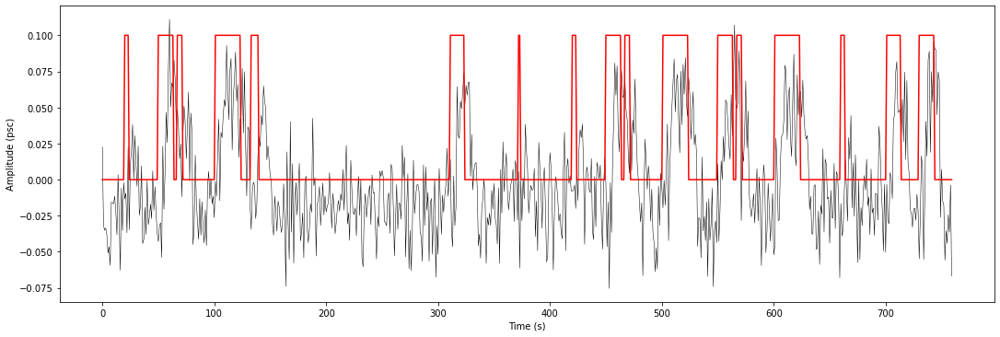

In [3]:
plt.figure(figsize=(15,5))
plt.plot(data_spc, label="Simulated", color="black", linewidth=0.5)
plt.plot(onsets*0.1, label="Onsets", color="red")
plt.tight_layout()
plt.xlabel("Time (s)")
plt.ylabel("Amplitude (psc)")

In [4]:
_, lambda_opt, coef_path, lambdas = solve_regularization_path(hrf, data_spc, n_scans)

In [5]:
df = pd.DataFrame(coef_path)
df["Time"] = np.arange(0, n_scans, 1)
df["Lambdas"] = lambdas

In [6]:
df

,0,1,2,3,4,5,6,7,8,9,...,752,753,754,755,756,757,758,759,Time,Lambdas
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.066968,-0.067299,-0.067932,-0.068257,-0.068314,-0.068577,-0.068635,-0.068728,0,0.000550
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.011979,0.012581,0.013731,0.014322,0.014426,0.014904,0.015009,0.015179,1,0.000483
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2,0.000455
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.007860,0.006908,0.005092,0.004158,0.003994,0.003239,0.003073,0.002805,3,0.000451
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.005300,0.006267,0.008111,0.009060,0.009226,0.009993,0.010161,0.010433,4,0.000447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.087419,-0.087443,-0.087489,-0.087513,-0.087517,-0.087537,-0.087570,-0.087623,755,0.000003
756,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,756,0.000003
757,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,757,0.000003
758,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,758,0.000003


In [7]:
lambda_opt_id = np.where(lambdas == lambda_opt)[0][0]

In [8]:
lambda_opt_id

58

In [9]:
df_clean = pd.DataFrame()
df_clean["Data"] = data_clean*0.01
df_clean["Time"] = np.arange(0, n_scans, 1)

In [10]:
# Convert scalars to scientific notation
def to_scientific(x):
    return "{:.2e}".format(x)

In [11]:
# Estimates figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, n_scans, 1):
    fig.add_trace(
        go.Scatter(visible=False,
                   line=dict(color="blue", width=1),
                   name=f"λ = {to_scientific(lambdas[step])}",
                   x=np.arange(0, n_scans, 1),
                   y=coef_path[:, step]
                  )
    )
    
fig.data[lambda_opt_id].visible = True

# Get the number of coefficient traces (before adding the BOLD trace)
n_coef = len(fig.data)

steps = []
for i in range(n_coef):
    # Build a visible list: only the selected coefficient trace is visible, 
    # and always keep the BOLD trace visible (added as last trace).
    visible_list = [False] * n_coef + [True]
    visible_list[i] = True

    step = dict(
        method="update",
        args=[{"visible": visible_list}],
        label=f"{to_scientific(lambdas[i])}"
    )
    steps.append(step)

sliders = [dict(
    active=lambda_opt_id,
    currentvalue={"prefix": "λ: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
    xaxis=dict(title='Time (s)'),
    yaxis=dict(title='Amplitude'),
)

bold = go.Scatter(visible=True,
                  line=dict(color="black", width=0.75),
                  name="Simulated BOLD data",
                  x=np.arange(0, n_scans, 1),
                  y=data_clean * 0.01)
fig.add_trace(bold)

fig.update_layout(
    sliders=sliders,
    xaxis=dict(title='Time (s)'),
    yaxis=dict(title='Amplitude'),
)

In [13]:
# Save as json
fig.write_json("../charts/regularization_figure_spike.json")

## Block model

In [14]:
hrf_generator = HRFMatrix(te=[0], block=True)
hrf = hrf_generator.generate_hrf(tr=tr, n_scans=n_scans).hrf_

_, lambda_opt, coef_path, lambdas = solve_regularization_path(hrf, data_spc, n_scans)

df = pd.DataFrame(coef_path)
df["Time"] = np.arange(0, n_scans, 1)
df["Lambdas"] = lambdas

lambda_opt_id = np.where(lambdas == lambda_opt)[0][0]

df_clean = pd.DataFrame()
df_clean["Data"] = data_clean*0.01
df_clean["Time"] = np.arange(0, n_scans, 1)

In [15]:
# Estimates figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, n_scans, 1):
    fig.add_trace(
        go.Scatter(visible=False,
                   line=dict(color="blue", width=1),
                   name=f"λ = {to_scientific(lambdas[step])}",
                   x=np.arange(0, n_scans, 1),
                   y=coef_path[:, step]
                  )
    )
    
fig.data[lambda_opt_id].visible = True

# Get the number of coefficient traces (before adding the BOLD trace)
n_coef = len(fig.data)

steps = []
for i in range(n_coef):
    # Build a visible list: only the selected coefficient trace is visible, 
    # and always keep the BOLD trace visible (added as last trace).
    visible_list = [False] * n_coef + [True]
    visible_list[i] = True

    step = dict(
        method="update",
        args=[{"visible": visible_list}],
        label=f"{to_scientific(lambdas[i])}"
    )
    steps.append(step)

sliders = [dict(
    active=lambda_opt_id,
    currentvalue={"prefix": "λ: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
    xaxis=dict(title='Time (s)'),
    yaxis=dict(title='Amplitude'),
)

bold = go.Scatter(visible=True,
                  line=dict(color="black", width=0.75),
                  name="Simulated BOLD data",
                  x=np.arange(0, n_scans, 1),
                  y=data_clean * 0.01)
fig.add_trace(bold)

fig.update_layout(
    sliders=sliders,
    xaxis=dict(title='Time (s)'),
    yaxis=dict(title='Amplitude'),
)

# Save as json
fig.write_json("../charts/regularization_figure_block.json")